In [2]:
import geopandas as gpd
import geoplot as gplt
import geoplot.crs as gcrs
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.colors import LogNorm
from matplotlib.gridspec import GridSpec
TrafficGdf = gpd.read_file(gplt.datasets.get_path('dc_roads'))

In [6]:
TrafficGdf

,id,aadt,geometry
0,0,20094,"LINESTRING (-76.98344 38.90013, -76.9833 38.90..."
1,1,1740,"MULTILINESTRING ((-76.99621 38.92511, -76.9962..."
2,2,2000,"LINESTRING (-76.98367 38.86053, -76.98367 38.8..."
3,3,2000,"LINESTRING (-76.99373 38.84623, -76.99323 38.8..."
4,4,2000,"LINESTRING (-77.01948 38.887, -77.01943 38.886..."
...,...,...,...
3442,3442,10186,"LINESTRING (-77.04166 38.91678, -77.04166 38.9..."
3443,3443,2000,"LINESTRING (-77.04885 38.8921, -77.04886 38.89..."
3444,3444,4810,"LINESTRING (-77.04167 38.91153, -77.04167 38.9..."
3445,3445,2000,"LINESTRING (-76.97574 38.92299, -76.97571 38.9..."


In [14]:
def GetPlotKwargs(Column = 'aadt',cmap = "inferno"):
    return {"projection": gcrs.AlbersEqualArea(),
            "scale": Column,
            "hue": Column,
            "cmap": cmap,
            "norm": LogNorm(),
            "legend": True}


/home/alberto/anaconda3/envs/geoplots/lib/python3.12/site-packages/geoplot/geoplot.py:248: UserWarning: Please specify "legend_var" explicitly when both "hue" and "scale" are specified. Defaulting to "legend_var='hue'".
  warnings.warn(


<GeoAxes: >

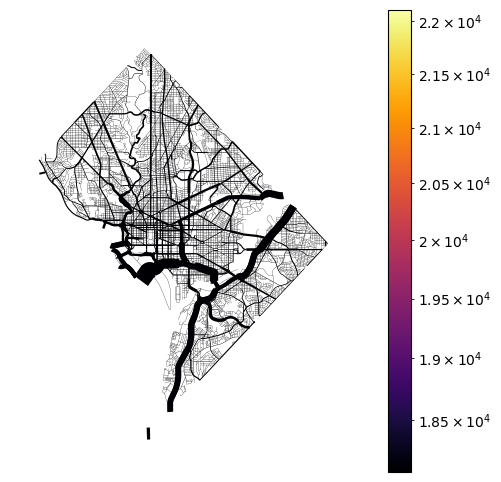

In [45]:
#fig,ax = plt.subplots(1,1,figsize=(15,15),dpi = 200)
gplt.sankey(TrafficGdf,projection=gcrs.AlbersEqualArea(),scale='aadt',limits=(0.1, 10),hue='aadt',cmap='inferno',norm = LogNorm(),legend=True)


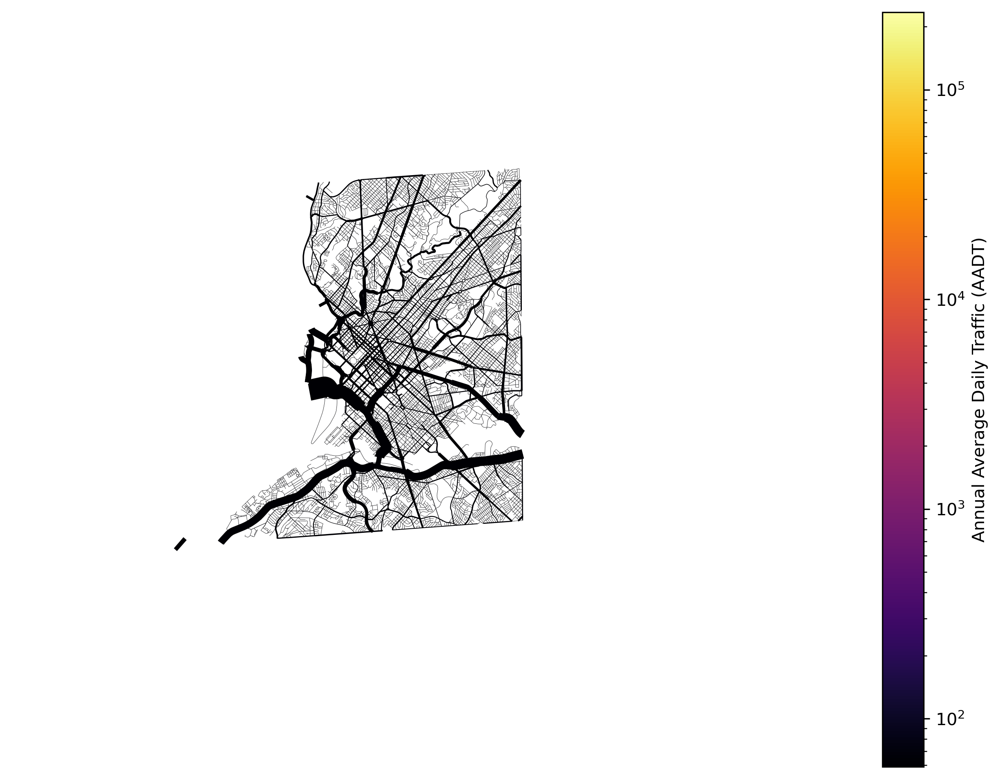

# Trying Geopandas

In [3]:
import osmnx as ox
import os
City = "BOS"
File = os.path.join(os.environ["TRAFFIC_DIR"],'data','carto',City,City + '_new_tertiary_simplified.graphml')
def GetGeopandas(File):
    if os.path.isfile(File):
        G = ox.load_graphml(File)
        GeoJson = ox.graph_to_gdfs(G, nodes=False, edges=True, node_geometry=False, fill_edge_geometry=True)
    return GeoJson
Geojson = GetGeopandas(File)

In [37]:
import matplotlib.pyplot as plt
import numpy as np
from OSMConstants import *
def Mph2Kmh(Mph):
    return Mph * 1.60934
def StrMph2IntMph(StrMph):
    if type(StrMph) == list:
        StrMph = StrMph[0]
        if type(StrMph) == str:
            if len(StrMph.split(' '))==1:
                Mph = int(StrMph)
                if np.isnan(Mph):
                    Mph = 50

            elif len(StrMph.split(' '))==2:
                Mph = int(StrMph.split(' ')[0])
            else:
                Mph = 0

    elif type(StrMph) == str:
        if len(StrMph.split(' '))==1:
            Mph = int(StrMph)
            if np.isnan(Mph):
                Mph = 50

        elif len(StrMph.split(' '))==2:
            Mph = int(StrMph.split(' ')[0])
        else:
            Mph = 0
    
    elif type(StrMph) == int:
        Mph = StrMph
    elif type(StrMph) == float:
        Mph = int(StrMph)
    else:
        Mph = 0

    return Mph
def ExtractUniqueValuesHighwayFromGeojson(Geojson):
    ListUnique = np.array([])
    for i in Geojson['highway'].to_numpy():
        if isinstance(i,list):
            if i[0] not in ListUnique:
                ListUnique = np.append(ListUnique,i[0])
            else:
                pass
        else:
            if i not in ListUnique:
                ListUnique = np.append(ListUnique,i)
            else:
                pass
    return ListUnique

def LanesInt(Lanes):
    Symbols = [' ','|',';','/','\\',',']
    # If Lanes is a Str, 
    if type(Lanes) == str:
        # "Number ..." -> int("Number")
        for Symbol in Symbols:
            if Symbol in Lanes:
                Lanes = Lanes.split(Symbol)[0]
                SecondLevel = False                
                for Symbol in Symbols:
                    if Symbol in Lanes:       
                        Lanes = int(Lanes.split(Symbol)[0])         
                        SecondLevel = True
                        break
                if SecondLevel == False:
                    Lanes = int(Lanes)
                Lanes = int(Lanes.split(Symbol)[0])
                if np.isnan(Lanes):
                    Lanes = 0
                break
        if type(Lanes) == int:
            pass
    elif type(Lanes) == list:
        for Symbol in Symbols:
            if Symbol in Lanes:
                Lanes = Lanes.split(Symbol)[0]
                SecondLevel = False                
                for Symbol in Symbols:
                    if Symbol in Lanes:       
                        Lanes = int(Lanes.split(Symbol)[0])         
                        SecondLevel = True
                        break
                if SecondLevel == False:
                    Lanes = int(Lanes)
                Lanes = int(Lanes.split(Symbol)[0])
                if np.isnan(Lanes):
                    Lanes = 0
                break
    else:
        Lanes = 0
    return Lanes

def Highway2Capacity(Highway,Lanes,osm_road_capacities_us):
    if Highway in osm_road_capacities_us.keys():
        Capacity = osm_road_capacities_us[Highway]*Lanes
    else:
        Capacity = 0
    return Capacity

Geojson['maxspeed'] = Geojson['maxspeed'].apply(StrMph2IntMph)
Geojson['lanes'] = Geojson['lanes'].apply(LanesInt)
Geojson["capacity"] = Geojson.apply(lambda x: Highway2Capacity(x['highway'],x['lanes'],osm_road_capacities_us),axis=1)
RoadType = ExtractUniqueValuesHighwayFromGeojson(Geojson)
plt.hist(Geojson['maxspeed'],bins = 50)
plt.xlabel('Max Speed [Mph]')
plt.show()
plt.hist(Geojson['capacity'],bins = len(RoadType))
plt.xlabel('Capacity [veh/hour]')
plt.show()

2
0
2
2
2
2
2
2
2
2
0
2
2
2
1
2
2
2
0
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
0
2
2
2
2
2
2
2
2
2
0
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
0
2
2
0
2
2
0
2
2
2
2
2
2
2
2
2
2
2
1
2
2
0
0
2
2
2
2
2
2
2
2
2
2
0
2
2
2
2
2
2
2
2
2
2
2
0
2
2
2
2
2
4
2
2
2
2
2
2
2
0
2
2
2
0
0
2
2
2
2
0
2
2
2
2
0
2
2
2
2
2
0
2
2
1
0
0
0
1
0
2
2
2
0
2
2
2
2
1
2
2
0
2
2
2
2
2
0
2
2
5
2
2
2
2
1
2
2
2
0
0
2
2
2
0
2
2
2
2
2
2
2
2
0
2
2
2
2
2
2
4
4
2
2
2
2
2
2
1
2
2
2
2
1
2
2
2
2
2
2
2
2
0
2
2
2
2
2
2
2
1
2
2
0
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
0
2
2
2
2
2
2
0
0
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
0
0
0
2
2
2
0
2
2
0
2
2
2
2
2
2
2
2
2
2
1
2
2
2
1
2
2
2
2
2
0
2
2
2
2
2
2
2
2
2
2
2
0
0
0
1
2
2
2
2
2
2
2
2
2
2
2
2
2
0
0
0
1
2
2
2
1
1
2
2
1
2
2
2
2
1
2
2
2
1
1
2
2
2
2
2
2
2
2
1
1
2
2
2
2
2
4
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
0
2
2
1
2
1
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
4
4
1
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
2
1
2
2
2
2
2
2
1
2
1
2
2
2
2
1
2
2
2
2
1
2
0
0


ValueError: invalid literal for int() with base 10: '2;'

In [22]:
import numpy as np


['secondary' 'secondary_link' 'unclassified' 'tertiary' 'primary_link'
 'primary' 'motorway_link' 'motorway' 'tertiary_link' 'trunk' 'trunk_link']


In [ ]:
G = ox.load_graphml(File)


In [7]:
(G.__dict__)

{'graph': {'created_date': '2024-01-18 01:13:17',
  'created_with': 'OSMnx 1.8.0',
  'crs': 'epsg:4326',
  'simplified': True},
 '_node': {61816807: {'y': 41.995558, 'x': -70.844629, 'street_count': 3},
  61817002: {'y': 41.996081, 'x': -70.843934, 'street_count': 3},
  61817016: {'y': 41.973369, 'x': -70.866671, 'street_count': 3},
  61817409: {'y': 41.995529, 'x': -70.84401, 'street_count': 4},
  61817412: {'y': 41.993312, 'x': -70.872564, 'street_count': 3},
  61817537: {'y': 41.999359, 'x': -70.84332, 'street_count': 2},
  61818775: {'y': 41.9926086, 'x': -70.8683617, 'street_count': 3},
  61818824: {'y': 41.973625, 'x': -70.866954, 'street_count': 3},
  61818875: {'y': 41.9942185, 'x': -70.8775284, 'street_count': 3},
  61819222: {'y': 41.9959, 'x': -70.844203, 'street_count': 4},
  61819564: {'y': 41.995625, 'x': -70.831246, 'street_count': 3},
  61819667: {'y': 41.9715348, 'x': -70.8997296, 'street_count': 3},
  61819850: {'y': 41.982238, 'x': -70.863335, 'street_count': 3},
  6